In [ ]:
#import Pkg
#Pkg.status("UniversalDiffEq")


Status `~/Documents/GitHub/SpatiallyReplicatedUDEs/Project.toml`
  [791b002b] UniversalDiffEq v1.2.0 `https://github.com/Jack-H-Buckner/UniversalDiffEq.jl.git#main`


    Updating registry at `~/.julia/registries/General.toml`
    Updating git-repo `https://github.com/Jack-H-Buckner/UniversalDiffEq.jl.git`


Pkg.Resolve.ResolverError: Unsatisfiable requirements detected for package [38;5;13mOrdinaryDiffEq [1dea7af3][39m:
 [38;5;13mOrdinaryDiffEq [1dea7af3][39m log:
 ├─possible versions are: [38;5;13m4.0.0 - 6.92.0[39m or uninstalled
 ├─restricted to versions [38;5;13m6.58 - 6.80.1[39m by [38;5;2mUniversalDiffEq [791b002b][39m, leaving only versions: [38;5;13m6.58.0 - 6.80.1[39m
 │ └─[38;5;2mUniversalDiffEq [791b002b][39m log:
 │   ├─possible versions are: [38;5;2m1.3.0[39m or uninstalled
 │   ├─restricted to versions [38;5;2m1.2.0 - 1[39m by [38;5;6mproject [6f1eb1ec][39m, leaving only versions: [38;5;2m1.3.0[39m
 │   │ └─[38;5;6mproject [6f1eb1ec][39m log:
 │   │   ├─possible versions are: [38;5;6m0.0.0[39m or uninstalled
 │   │   └─[38;5;6mproject [6f1eb1ec][39m is fixed to version [38;5;6m0.0.0[39m
 │   └─[38;5;2mUniversalDiffEq [791b002b][39m is fixed to version [38;5;2m1.3.0[39m
 └─restricted to versions [38;5;13m6.91.0[39m by an explicit requirement — no versions left

In [1]:

using DataFrames, CSV, UniversalDiffEq, Plots, Statistics, CategoricalArrays, ComponentArrays, Distributions


# Kelp forest NODE model

This is a relatively simple model for kelp forest dynamics that accounts for differences between 6 sites around San Nicolas Island. It describes changes in the log abundance of juvenile kelp (less than one meter) $u_{J,i}$ and adult kelp $u_{A,i}$ at each site (index by $i$) as a function of their current log abundances, the log abundnace of purple sea urchins $X_{p,i}(t)$ and location effects $X_i$. We assume no prior knowedge of these relationships and use a nerual network to learn the relevant funtional forms

$$
\frac{du_{J,i}}{dt} = NN_J(u_{J,i},u_{A,t}, X_{p,i}(t), X_i) \\
\frac{du_{A,i}}{dt} = NN_A(u_{J,i},u_{A,t}, X_{p,i}(t), X_i)
$$

We have chosen to model the effect of purple sea urchins on kelp abundance rather than red sea urchins given their relatively higher abundance.

The effects of location on the population dynamics are captured by a covarite $X_i$ that varies by site but not over time. In the simplest case we ignore $X_i$ and assume the dynamics are identical between sites. In the second case we assume there are unobserved site level factors that influence the dynamics which we model by passing an indicator varaible to the neural network and the final case assumes differnces in dynamics between location can be explained by the rugosity, or the roughness of the sea floor, at each location.  


In [2]:
dat = CSV.read("../data/processed_time_series.csv", DataFrame)[:,2:end]
rename!(dat, ["time","series","juv","adult"])
training = dat[dat.time .< 55,:]
testing = dat[dat.time .>= 55,:]

X = CSV.read("../data/processed_rugosity.csv", DataFrame)[:,[2,3,5,7]]
rename!(X, ["time","series", "urchin",  "rugosity"])
dat[1:4,:]

Row,time,series,juv,adult
,Int64,Int64,Float64,Float64
1,1,1,-1.0498,-0.197155
2,1,2,-0.0421156,-0.394327
3,1,3,0.377395,0.211176
4,1,4,-1.28535,-0.113676


In [3]:
Vars = CSV.read("../data/kelp_obs_errors.csv", DataFrame)[:,2:end]
Σ_kelp = [Vars.sigma2[1] 0 ; 0 Vars.sigma2[2]]
Σ_kelp

2×2 Matrix{Float64}:
 0.0898678  0.0
 0.0        0.109365

In [4]:
X[1:4,:]

Row,time,series,urchin,rugosity
,Int64,Int64,Float64,Float64
1,1,1,-0.458772,-0.87251
2,1,23,1.06469,-0.87251
3,1,37,0.225657,-0.87251
4,1,47,0.286803,-0.87251


In [5]:
function series_indexes(dataframe,series_column_name,time_column_name)
    
    series = length(unique(dataframe[:,series_column_name]))
        
    inds = collect(1:nrow(dataframe))  
    starts = [inds[dataframe[:,series_column_name] .== i][1] for i in unique(dataframe[:,series_column_name])]
    lengths = [sum(dataframe[:,series_column_name] .== i) for i in unique(dataframe[:,series_column_name])]
    times = [dataframe[dataframe[:,series_column_name] .== i,time_column_name] for i in unique(dataframe[:,series_column_name])]  

    return series, inds, starts, lengths, times
end 

function process_multi_data(data, time_column_name, series_column_name)

    time_alias_ = time_column_name
    series_alias_ = series_column_name

    # collect series index names 
    labels_df = DataFrame(label = unique(data[:,series_alias_]),
                         index = levelcode.(CategoricalArray(unique(data[:,series_alias_])))
                        )
    
    inds = levelcode.(CategoricalArray(data[:,series_alias_]))
    data.series .= inds

    dataframe = sort!(data,["series",time_alias_])
    times = dataframe[:,time_alias_]
    series =dataframe.series
    T = times[argmax(times)]
    
    N = length(times); dims = size(dataframe)[2] - 2
    inds_time = names(dataframe).!=time_alias_ 
    inds_series = (names(dataframe).!=series_alias_) .& (names(dataframe).!= "series")
    varnames = names(dataframe)[inds_time .& inds_series]
    data = transpose(Matrix(dataframe[:,varnames]))

    series, inds, starts, lengths, times_ls= series_indexes(dataframe,series_column_name,time_column_name)
    dims = size(data)[1]
    return N, T, dims, data, times,  dataframe, series, inds, starts, lengths, varnames, labels_df
end 

process_multi_data (generic function with 1 method)

In [6]:
function plot_state_estimates_indiv(UDE::MultiUDE; show_legend = true, plot_width = 1000, plot_height = 700)
    plots = []  # To store the individual plots for later combining

    # Process the multi-data inputs
    N, T, dims, data, times, dataframe, series, inds, starts, lengths, labs = process_multi_data(UDE.data_frame, UDE.time_column_name, UDE.series_column_name)

    # Loop over each dimension
    for d in 1:dims
        # Loop over each series
        for series_idx in eachindex(starts)
            plt = plot(size = (plot_width, plot_height))  # Set size for the plot
            NRMSE = 0  # Initialize NRMSE for this series

            # Extract data for the current series and dimension
            uhat = UDE.parameters.uhat[:, starts[series_idx]:(starts[series_idx] + lengths[series_idx] - 1)]
            time = times[starts[series_idx]:(starts[series_idx] + lengths[series_idx] - 1)]
            dat = data[:, starts[series_idx]:(starts[series_idx] + lengths[series_idx] - 1)]

            # Model prediction using the observation model
            yhat = broadcast(t -> UDE.observation_model.link(uhat[:, t], UDE.parameters.observation_model)[d], eachindex(time))

            # Retrieve the label for the series
            series_lab = UDE.series_labels.label[UDE.series_labels.index .== series_idx][1]

            # Plot the data points for this series
            scatter!(plt, time, dat[d, :], label = "Data - Series $series_idx", width = 0.5)

            # Plot the model prediction for this series
            plot!(plt, time, yhat, label = string(series_lab), xlabel = "Time", ylabel = UDE.varnames[d], color = :blue, width = 2, linestyle = :dash)

            # Compute the NRMSE for this series
            NRMSE += sqrt(sum((dat[d, :] .- yhat).^2) / length(dat[d, :])) / std(dat[d, :])

            # Annotate the plot with the NRMSE
            ylim = ylims(plt)
            ypos = (ylim[2] - ylim[1]) * 0.925 + ylim[1]
            xlim = xlims(plt)
            xpos = (xlim[2] - xlim[1]) * 0.750 + xlim[1]
            nrmse = round(NRMSE / length(starts), digits = 3)

            # Decide on whether to show legend based on the flag
            if show_legend
                annotate!(plt, [xpos], [ypos], text(string("Mean NRMSE: ", nrmse), 9), legend_position = :outerbottomright)
            else
                annotate!(plt, [xpos], [ypos], text(string("Mean NRMSE: ", nrmse), 9), legend_position = :none)
            end

            # Push the individual plot to the plots array
            push!(plots, plt)
        end
    end

    # Combine all the individual plots into one for display with better layout
    return plot(plots..., layout = (ceil(Int, length(plots) / 2), 2), size = (2000, 1400))  # Bigger combined size and grid layout
end


plot_state_estimates_indiv (generic function with 1 method)

In [38]:
function blank_DF(times, series, var_names)
    N = length(times)
    M=length(series)
    time_vals = reduce(vcat,[times for i in series])
    series_vals = reduce(vcat,[repeat([i],N) for i in series])
    dat = DataFrame(zeros(N*M,length(var_names)),var_names)
    dat.time = time_vals
    dat.series = series_vals
    return dat
end 

blank_DF (generic function with 1 method)

# Model Fixed between sites

In this simplest case I assume the dynamcis are identical between sites. 

$$
\frac{du_{J,i}}{dt} = NN_J(u_{J,i},u_{A,t}, X_{p,i}(t)) \\
\frac{du_{A,i}}{dt} = NN_A(u_{J,i},u_{A,t}, X_{p,i}(t))
$$

In [7]:
NN, NNparameters = SimpleNeuralNetwork(2+1,2, hidden = 5)

function derivs_1!(u,i,X,p,t)
    NN(vcat(u,X[1:1]), p.NN) # index 3 is pycnopodia 
end

init_parameters = (NN = NNparameters, )

# proc_weight and obs_weight are process noise and observation noise respectively. this tells the model how much of each there is relative to one another
model_1 = MultiCustomDerivatives(training,X,derivs_1!,init_parameters;
                proc_weight=2.25,obs_weight=1.0,reg_weight=10^-4,
                time_column_name = "time", series_column_name = "series")

nothing

In [8]:
train!(model_1,loss_function = "conditional likelihood", optim_options = (maxiter = 100,))

27260.544 26049.897 25024.5 24043.776 23138.901 22308.911 21538.811 20813.701 20124.897 19469.787 18848.471 18260.819 17705.242 17178.851 16678.409 16201.39 15746.657 15314.468 14905.83 14521.476 14160.898 13821.926 13501.235 13195.563 12902.965 12623.097 12356.647 12104.661 11867.743 11645.109 11434.34 11232.443 11037.459 10849.304 10669.28 10498.482 10336.229 10180.362 10029.592 9884.795 9747.274 9616.346 9489.632 9365.776 9245.857 9131.396 9021.408 8913.3 8806.851 8703.761 8603.665 8504.584 8406.578 8310.884 8216.289 8121.339 8027.405 7934.661 7841.836 7749.967 7658.984 7567.849 7478.29 7389.708 7301.78 7215.456 7129.457 7044.932 6960.833 6877.835 6795.133 6713.24 6631.548 6550.673 6470.109 6390.865 6312.542 6235.755 6160.791 6087.41 6015.978 5946.621 5879.478 5814.818 5753.4 5697.738 5663.753 5665.331 5585.504 5537.003 5524.074 5450.24 5459.851 5394.742 5374.08 5356.485 5302.601 5308.174 5257.794 5241.699 5241.699 

In [9]:
Pν, Px = UniversalDiffEq.kalman_filter!(model_1, Σ_kelp, verbose = true, maxiter = 100, step_size = 0.05)
Pν, Px= UniversalDiffEq.kalman_filter!(model_1, Σ_kelp; Pν = Pν, verbose = true, maxiter = 250, step_size = 0.01)

3335.212 1606.831 1698.224 1356.975 1210.462 1077.755 1027.462 1000.264 985.272 977.772 974.645 970.039 964.288 957.415 948.415 936.215 923.621 911.486 899.525 889.86 880.881 872.289 864.415 857.325 850.921 845.063 839.665 834.663 829.942 825.387 820.931 816.456 811.969 807.368 802.805 798.131 794.152 790.214 786.743 783.663 780.86 778.275 775.899 773.775 771.903 770.258 768.78 767.4 766.055 764.704 763.328 761.939 760.552 759.204 757.857 756.834 755.497 754.385 753.318 752.292 751.292 750.312 749.349 748.402 747.473 746.565 745.681 744.821 743.986 743.172 742.358 741.599 740.841 740.074 739.327 738.592 737.87 737.162 736.477 735.788 735.131 734.484 733.849 733.233 732.625 732.024 731.435 730.849 730.272 729.703 729.141 728.586 728.06 727.53 726.971 726.446 725.924 725.405 724.89 724.376 724.376 724.376 722.409 720.517 718.757 717.027 715.386 713.841 712.328 710.851 709.432 708.044 706.665 705.301 703.961 702.64 701.286 700.056 698.786 697.541 696.346 695.164 693.998 692.849 691.714 69

([0.8475731326537027 0.0; 0.0 0.5985135093681158], [0.0 0.0; 0.0 0.0;;; 0.8672118184405626 0.01552700494208055; 0.015527004942133087 0.6397739546133197;;; 0.9120872078274791 0.012772686668855393; 0.01277268666946918 0.6796449974109463;;; … ;;; 0.9305549512003727 0.010763869203890275; 0.01076386920389183 0.6530007236423394;;; 0.9300051710460472 0.008483625063915312; 0.008483625063915312 0.6582430270983938;;; 0.9300993980822779 0.004568722639926331; 0.004568722639926331 0.676673825205108])

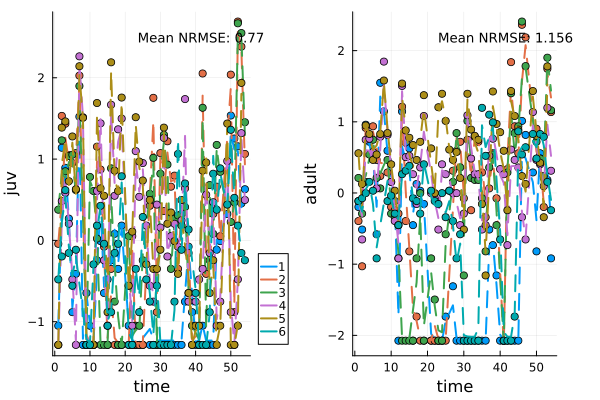

In [10]:
plot_state_estimates(model_1)

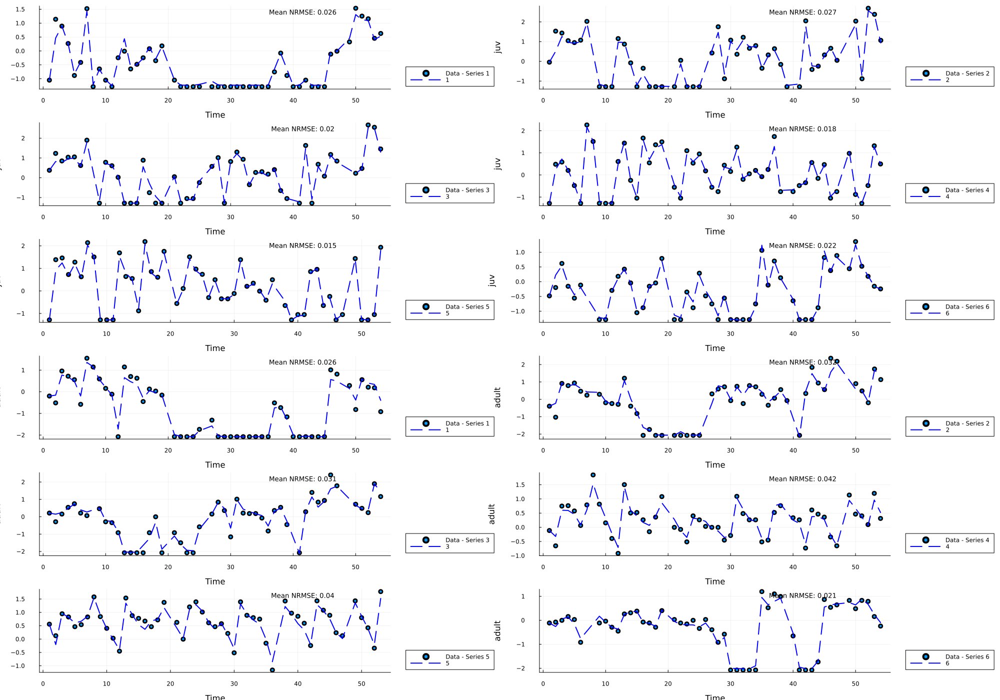

In [11]:
plot_state_estimates_indiv(model_1)

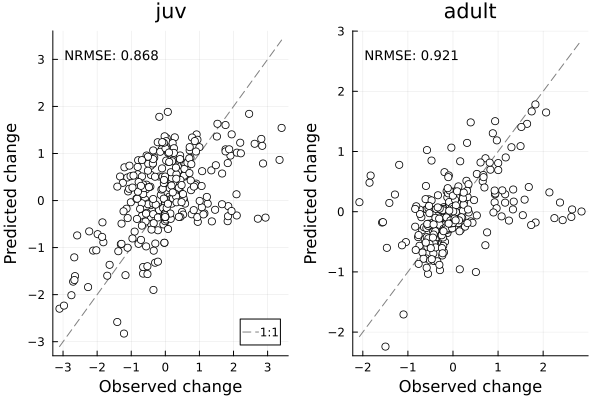

In [12]:
plot_predictions(model_1)

Simulate the predicted dynamics

In [20]:
include("/Users/cheyennejarman/Documents/GitHub/SpatiallyReplicatedUDEs/src/cross_validation.jl")

leave_future_out (generic function with 1 method)

In [21]:
forecast_data(model_1, testing)

Row,series,time,juv,adult
,Int64,Int64,Float64,Float64
1,1,55,0.791881,0.1873
2,1,57,0.628644,0.550954
3,1,61,0.649304,0.479347
4,1,63,0.633285,0.470721
5,1,64,0.637684,0.470147
6,1,65,0.6394,0.471849
7,1,67,0.637587,0.472139
8,1,68,0.637674,0.471814
9,1,69,0.637977,0.471847


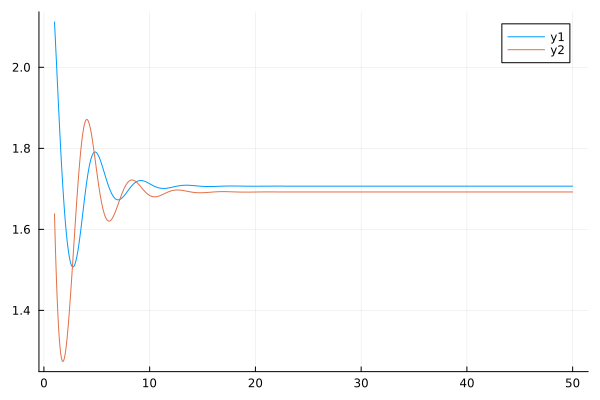

In [24]:
site = 4
with_noise = false
sigma = 1.0

rhs = u -> model_1.process_model.right_hand_side(u,site,[0,0,1.0],model_1.parameters.process_model,0)
u = [0.5,0.75]
dt_ = 0.01
kelp = []
j_kelp = []

for i in 1:dt_:50
    u = u .+ dt_*rhs(u)
    if with_noise 
        u =  u .+ dt_ .* [sigma,0] .* (rand(Normal(0,1),2)) 
    end 
    push!(kelp,u[2])
    push!(j_kelp,u[1])
end
Plots.plot(1:dt_:50,exp.(kelp))
Plots.plot!(1:dt_:50,exp.(j_kelp))

In [42]:
model_1_forecast = blank_DF(77:100, 1:6, ["juv","adult"])

Row,juv,adult,time,series
,Float64,Float64,Int64,Int64
1,0.0,0.0,77,1
2,0.0,0.0,78,1
3,0.0,0.0,79,1
4,0.0,0.0,80,1
5,0.0,0.0,81,1
6,0.0,0.0,82,1
7,0.0,0.0,83,1
8,0.0,0.0,84,1
9,0.0,0.0,85,1


In [46]:
#p1, (p2,p3) = UniversalDiffEq.plot_forecast(model_1_forecast, 50)
#p1

# Model with site level indicators

I include site level indicator variables with a one-hot encoding which is a vector of zeros accept for one entry hat takes the value of one representing the site under consideration.  for example if there were four sites and we wanted to ake a prediciton for the third the one-hot encoding vector would be 

$$
X_3 = \{0,0,1,0\}
$$


In [28]:
NN, NNparameters = UniversalDiffEq.SimpleNeuralNetwork(2+7,2,hidden = 5)

function derivs_2!(du,u,i,X,p,t)
    index = round(Int,i)
    one_hot = zeros(6)
    one_hot[index] = 1
    inputs = vcat(vcat(u,X[1:1]),one_hot)
    du .=  NN(inputs ,p.NN)
end

init_parameters = (NN = NNparameters, )
# note process noise is higher than observed noise
model_2 = MultiCustomDerivatives(dat,X,derivs_2!,init_parameters;
                proc_weight=0.25,obs_weight=1.0,reg_weight=10^-6,
                time_column_name = "time", series_column_name = "series")
nothing

In [29]:
gradient_descent!(model_2, verbose = true, maxiter = 100, step_size = 0.05)

2.045 1.867 1.711 1.57 1.441 1.322 1.214 1.114 1.022 0.938 0.86 0.788 0.722 0.661 0.605 0.554 0.507 0.465 0.426 0.39 0.358 0.328 0.302 0.278 0.256 0.236 0.218 0.202 0.187 0.174 0.162 0.151 0.141 0.132 0.124 0.117 0.11 0.104 0.099 0.094 0.09 0.085 0.082 0.079 0.076 0.073 0.07 0.068 0.066 0.064 0.063 0.061 0.06 0.059 0.058 0.057 0.057 0.056 0.055 0.055 0.055 0.054 0.054 0.054 0.053 0.053 0.053 0.053 0.053 0.053 0.053 0.053 0.053 0.053 0.053 0.053 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.052 0.051 0.051 0.051 0.051 0.051 0.051 

In [30]:
gradient_descent!(model_2, verbose = true, maxiter = 100, step_size = 0.0125)

0.051 0.051 0.051 0.051 0.051 0.051 0.051 0.051 0.051 0.051 0.051 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.049 0.049 0.049 0.049 0.049 0.049 0.049 0.049 0.049 0.049 0.048 0.048 0.048 0.048 0.048 0.048 0.048 0.048 0.048 0.048 0.047 0.047 0.047 0.047 0.047 0.047 0.047 0.047 0.047 0.047 0.047 0.046 0.046 0.046 0.046 0.046 0.046 0.046 0.046 0.046 0.046 0.046 0.046 0.046 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.045 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 0.044 

In [31]:
Vars = CSV.read("../data/kelp_obs_errors.csv", DataFrame)[:,2:end]
Σ_kelp = [Vars.sigma2[1] 0 ; 0 Vars.sigma2[2]]
Σ_kelp
Pν,Px = UniversalDiffEq.kalman_filter!(model_2, Σ_kelp; verbose = true, maxiter = 150, step_size = 0.005)

3378.667 2892.487 2433.523 2175.193 2046.906 2013.063 2009.288 2008.335 2005.274 1997.98 1987.038 1972.588 1955.929 1937.956 1919.227 1900.706 1883.047 1867.202 1853.632 1840.253 1828.426 1817.628 1807.506 1797.015 1786.961 1777.136 1767.683 1757.874 1748.925 1740.345 1731.18 1722.951 1714.248 1705.762 1697.646 1690.01 1682.535 1675.642 1668.712 1662.06 1655.582 1649.457 1643.686 1636.914 1630.845 1627.701 1623.033 1618.101 1607.229 1608.771 1604.643 1600.359 1595.991 1592.63 1589.413 1585.83 1581.953 1578.075 1574.282 1571.014 1567.671 1564.898 1561.564 1557.429 1555.292 1551.067 1548.112 1544.922 1542.048 1539.243 1536.345 1533.07 1529.995 1526.912 1523.81 1520.61 1516.977 1513.196 1509.434 1506.85 1504.483 1502.037 1498.932 1495.542 1491.726 1487.91 1486.4 1483.597 1480.745 1477.712 1474.382 1471.49 1468.627 1465.875 1463.282 1460.574 1457.905 1455.157 1452.685 1450.106 1447.293 1444.706 1442.35 1439.929 1437.474 1434.974 1432.806 1430.487 1427.956 1426.015 1422.153 1421.538 1419.48

([0.3596044434752423 0.0; 0.0 0.33559546740561735], [0.0 0.0; 0.0 0.0;;; 0.4015737637316441 0.027777656244535; 0.027777656244548254 0.3810200818544637;;; 0.3965423086865787 0.034596816067909986; 0.034596816067909875 0.4030771164652152;;; … ;;; 0.44142163277044805 0.008987547457974143; 0.008987547457951495 0.4274825992960218;;; 0.43520507591490004 0.010973312296070459; 0.010973312296166604 0.427398134503262;;; 0.4350536452040571 0.0050517610236729404; 0.005051761023581375 0.42031443398598983])

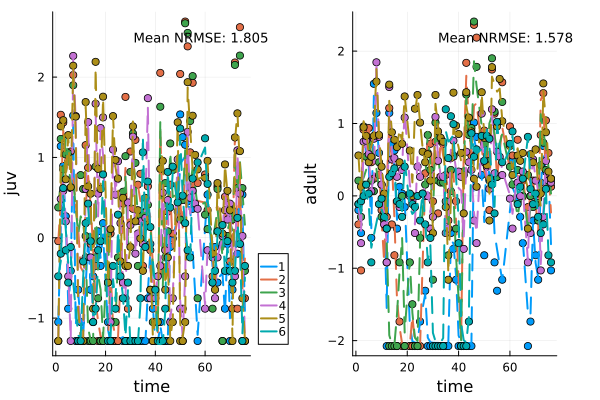

In [32]:
plot_state_estimates(model_2)

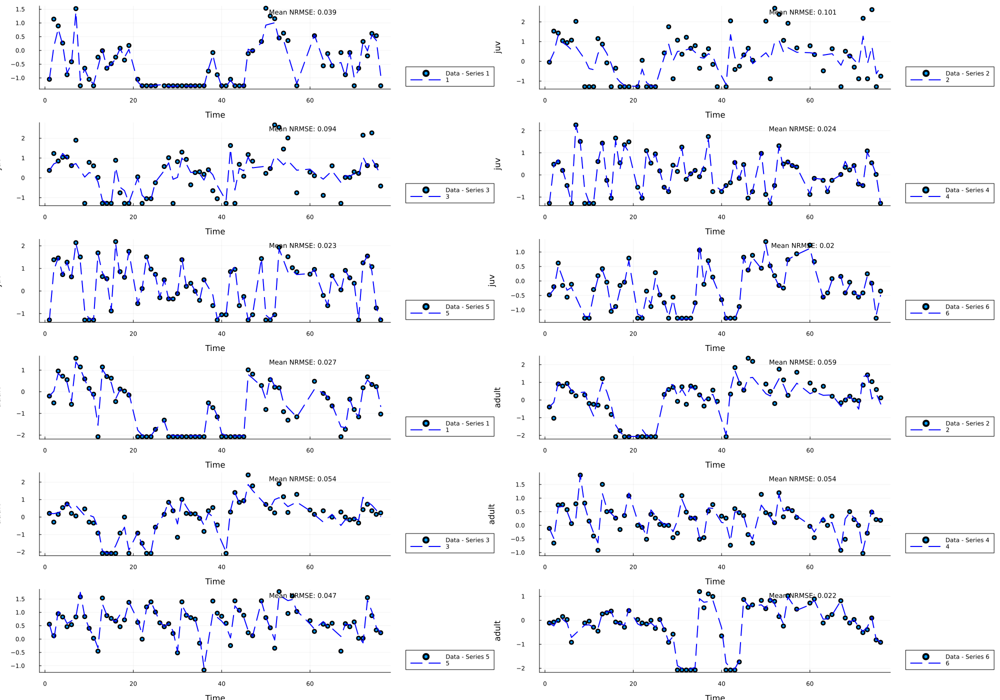

In [33]:
plot_state_estimates_indiv(model_2)

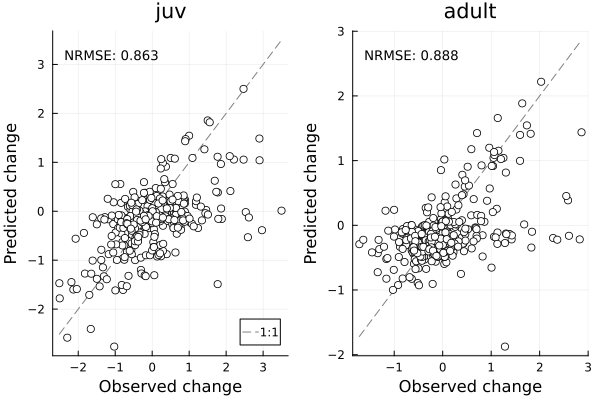

In [34]:
plot_predictions(model_2)

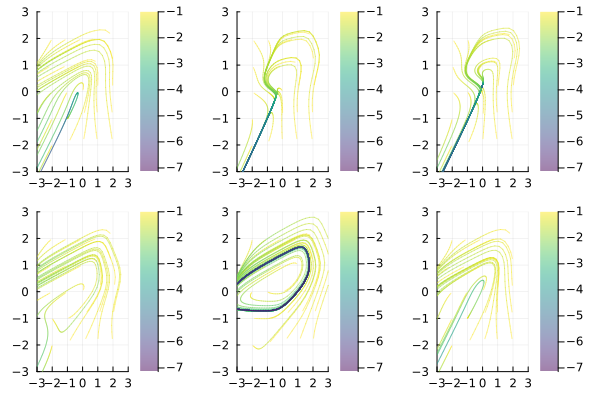

In [35]:
params = model_2.parameters.process_model
rhs_ = (u,i,x) -> model_2.process_model.right_hand_side(u,i,[x],params, 0)

function simulation(u0,rhs,j,x,dt,T)
    times = 0:dt:T
    uvals = zeros(length(times),length(u0))
    u = u0; i = 0
    for t in times 
        i += 1
        u = u .+ dt*rhs(u,j,x)
        uvals[i,:] .= u
    end
    return uvals, times
end 

plts = []; x = 1.0
for site in 1:6
    u0 = zeros(2)
    plt = Plots.plot()
    for u1 in -2.0:1.0:2.0
        for u2 in -2.0:1.0:2.0
            u, times = simulation([u1,u2],rhs_,site,x,0.1,50)
            Plots.plot!(plt,u[:,1],u[:,2], line_z = - sqrt.(times .+ 1), 
                        color = :viridis, label = "", legend = false,
                        alpha = 0.5)
        end
    end
    push!(plts,Plots.plot!(plt, xlims = (-3,3), ylims = (-3,3)))
end
plot(plts...)

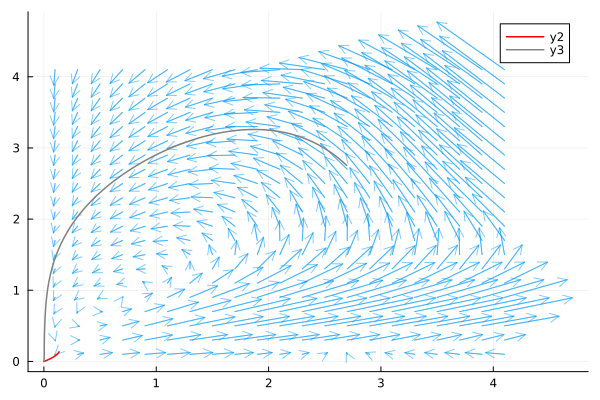

In [36]:
xs = 0.1:0.2:4.1
ys = 0.1:0.2:4.1

using LinearAlgebra

site = 4
x_ = 1.0
df(x, y) =  [x,y] .*rhs_(log.([x,y]),site,x_)./10

xxs = [x for x in xs for y in ys]
yys = [y for x in xs for y in ys]
u1, times = simulation([-2.0,-2.0],rhs_,site,x_,0.01,50)
u2, times = simulation([1.0,1.0],rhs_,site,x_,0.01,50)
quiver(xxs, yys, quiver=df, alpha = 0.5)
Plots.plot!(exp.(u1[:,1]),exp.(u1[:,2]), color = "red", width = 1.5)
Plots.plot!(exp.(u2[:,1]),exp.(u2[:,2]), color = "grey", width = 1.5)

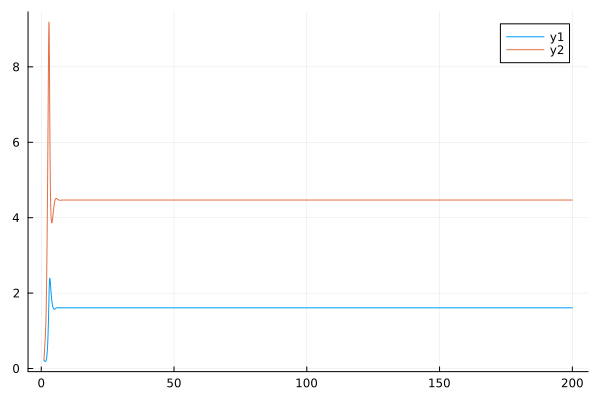

In [37]:
site = 4
with_noise = false
sigma = 0.25
pyc = -2.0

rhs = u -> model_2.process_model.right_hand_side(u,site,[pyc,0.0],model_2.parameters.process_model, 0)
u = [-1.5,-1.5]
dt = 0.01
kelp = []
j_kelp = []
ts = 1:dt:200
for i in ts
    u = u .+ dt*rhs(u)
    if with_noise 
        u =  u .+ dt .* sigma.* [1,0.1] .* rand(Normal(0,1),2)
    end 
    push!(kelp,u[2])
    push!(j_kelp,u[1])
end
Plots.plot(ts,exp.(kelp))
Plots.plot!(ts,exp.(j_kelp))

# Rugosity effects on dynamics 

for this last case I use site level measures of sea floor rugosity to explain differnce in the dynamcis betwen sites.  

In [47]:
NN, NNparameters = SimpleNeuralNetwork(2+2,2, hidden = 5)
function derivs_3!(du,u,i,X,p,t)
    inputs = vcat(u,X[1:2])
    du .=  NN(inputs,p.NN)
end

init_parameters = (NN = NNparameters, )

model_3 = MultiCustomDerivatives(training,X,derivs_3!,init_parameters;
                        proc_weight=1.0,obs_weight=1.0,reg_weight=10^-4,
                         time_column_name = "time", series_column_name = "series" )
nothing

In [48]:
gradient_descent!(model_3, verbose = true, maxiter = 250, step_size = 0.05)
#gradient_descent!(model_3, verbose = true, maxiter = 250, step_size = 0.025)

2.348 2.105 1.936 1.8 1.671 1.545 1.424 1.312 1.208 1.114 1.029 0.952 0.881 0.817 0.758 0.705 0.656 0.612 0.571 0.535 0.502 0.472 0.445 0.421 0.399 0.379 0.361 0.345 0.33 0.317 0.305 0.294 0.284 0.275 0.267 0.259 0.253 0.246 0.241 0.236 0.231 0.227 0.223 0.219 0.216 0.213 0.21 0.208 0.205 0.204 0.202 0.2 0.199 0.197 0.196 0.195 0.194 0.194 0.193 0.192 0.192 0.191 0.191 0.191 0.19 0.19 0.19 0.19 0.189 0.189 0.189 0.189 0.189 0.189 0.188 0.188 0.188 0.188 0.188 0.188 0.187 0.187 0.187 0.187 0.187 0.187 0.187 0.187 0.186 0.186 0.186 0.186 0.186 0.186 0.186 0.186 0.185 0.185 0.185 0.185 0.185 0.185 0.185 0.184 0.184 0.184 0.184 0.184 0.183 0.183 0.183 0.182 0.182 0.182 0.181 0.181 0.18 0.18 0.18 0.181 0.182 0.178 0.18 0.179 0.177 0.178 0.176 0.177 0.175 0.177 0.175 0.175 0.175 0.174 0.174 0.173 0.174 0.173 0.173 0.173 0.172 0.172 0.172 0.172 0.172 0.171 0.171 0.171 0.171 0.17 0.17 0.17 0.17 0.17 0.17 0.17 0.169 0.169 0.169 0.169 0.169 0.171 0.174 0.176 0.17 0.177 0.17 0.174 0.17 0.173 0.17

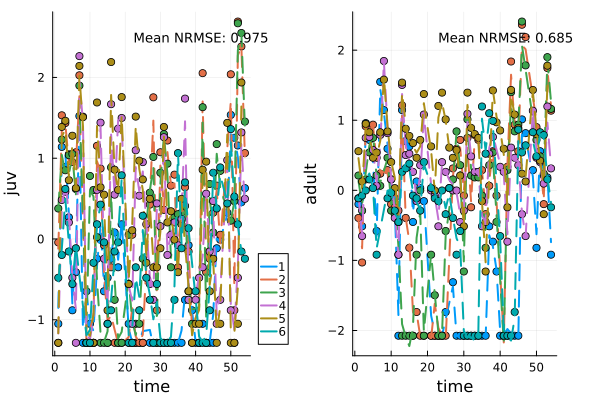

In [49]:
plot_state_estimates(model_3)

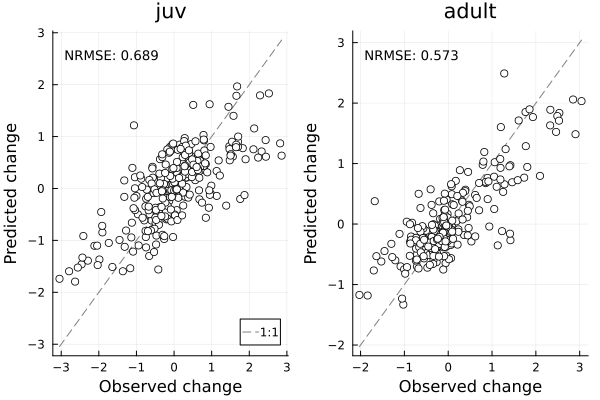

In [50]:
plot_predictions(model_3)

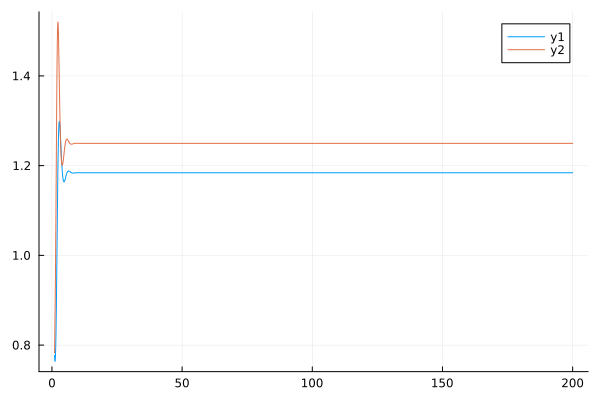

In [52]:
site = 4
pyc = 1.0
rug = 1.0
with_noise = false
sigma = 0.5
u = [-0.25,-0.25]

rhs = u -> model_3.process_model.right_hand_side(u,site,[0.0,0.0,pyc,rug],model_3.parameters.process_model,0)
dt = 0.01
kelp = []
j_kelp = []
ts = 1:dt:200
for i in ts
    u = u .+ dt*rhs(u)
    if with_noise 
        u =  u .+ dt .* sigma.* [1,0.1] .* rand(Normal(0,1),2)
    end 
    push!(kelp,u[2])
    push!(j_kelp,u[1])
end
Plots.plot(ts,exp.(kelp))
Plots.plot!(ts,exp.(j_kelp))

# kelp UDE model

$$
\frac{dJ}{dt} = J*NN_J(J,A) - gJ - J*NN_m(A,P(t),X_i)\\
\frac{dA}{dt} = gJ - A*NN_m(A,P(t),X_i)
$$

In [53]:
dat_UDE = CSV.read("../data/processed_time_series_no_log.csv", DataFrame)[:,2:end]
rename!(dat_UDE, ["time","series","juv","adult"])
training_UDE = dat_UDE[dat_UDE.time .< 55,:]
testing_UDE = dat_UDE[dat_UDE.time .>= 55,:]
training_UDE[1:4,:]

Row,time,series,juv,adult
,Int64,Int64,Float64,Float64
1,1,1,0.0121877,0.42306
2,1,2,0.182815,0.323517
3,1,3,0.402193,0.721691
4,1,4,0.0,0.472832


In [54]:


NNm, NNparameters_m = SimpleNeuralNetwork(2,2, hidden = 5)

function derivs_4!(du,u,i,X,p,t)
    mortality = NNm(vcat(u[2:2],X[1:1]),p.NNm)
    du1 = abs(p.r)*u[2] - abs(p.g)*u[1] - u[1]*abs(mortality[1])
    du2 = abs(p.g)*u[1] - u[2]*abs(mortality[2]) 
    du .= [du1,du2]
end

init_parameters = (NNm = NNparameters_m, g =0.15, r = 1.0)

model_4 = MultiCustomDerivatives(training_UDE,X,derivs_4!,init_parameters;
                proc_weight=1.0,obs_weight=1.0,reg_weight=10^-4,
                time_column_name = "time", series_column_name = "series")
                
model_4.loss_function(model_4.parameters)

10.787209119298

In [55]:
gradient_descent!(model_4, verbose = true, maxiter = 100, step_size = 0.05)


10.787 10.59 10.398 10.214 10.038 9.868 9.705 9.547 9.396 9.25 9.11 8.975 8.845 8.719 8.597 8.48 8.367 8.257 8.15 8.047 7.947 7.85 7.755 7.663 7.574 7.487 7.402 7.319 7.238 7.159 7.082 7.006 6.932 6.861 6.791 6.723 6.656 6.59 6.526 6.463 6.401 6.34 6.281 6.222 6.165 6.109 6.054 5.999 5.946 5.894 5.842 5.791 5.741 5.692 5.644 5.596 5.549 5.503 5.458 5.413 5.369 5.325 5.282 5.24 5.198 5.157 5.116 5.076 5.038 4.999 4.96 4.921 4.885 4.847 4.811 4.773 4.738 4.702 4.667 4.632 4.598 4.563 4.529 4.496 4.463 4.429 4.399 4.369 4.335 4.314 4.274 4.248 4.212 4.187 4.151 4.122 4.094 4.064 4.037 4.008 4.008 

In [ ]:
gradient_descent!(model_4, verbose = true, maxiter = 250, step_size = 0.025)

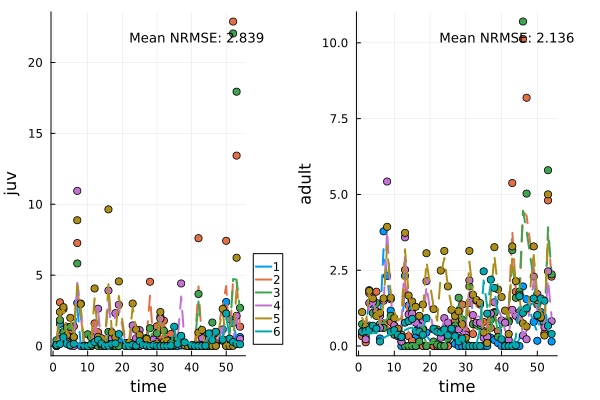

In [56]:
plot_state_estimates(model_4)

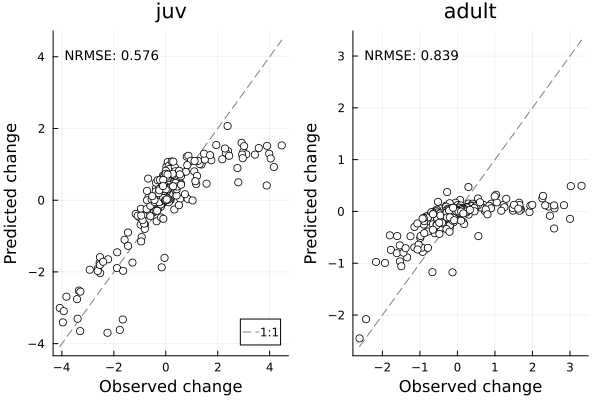

In [57]:
plot_predictions(model_4)

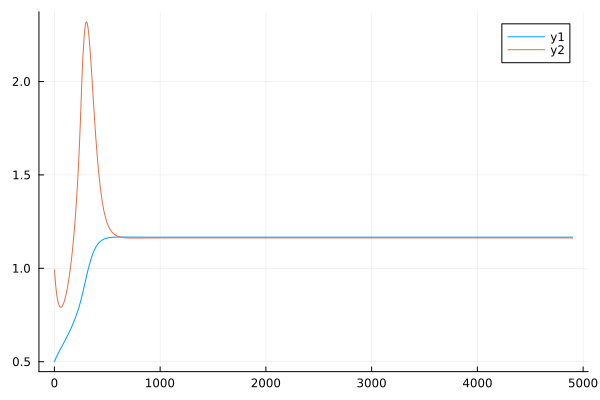

In [59]:
site = 4
pyc = 0.0
rug = 0.0
with_noise = false
sigma = 0.5
u = [1.0,0.5]

rhs = u -> model_4.process_model.right_hand_side(u,site,[pyc,rug],model_4.parameters.process_model, 0)

dt = 0.01
kelp = []
j_kelp = []
for i in 1:dt:50
    u = u .+ dt*rhs(u)
    if with_noise 
        u =  u .+ dt .*  [sigma,0.0] .* rand(Normal(0,1),2)
    end 
    push!(kelp,u[2])
    push!(j_kelp,u[1])
end
Plots.plot(kelp)
Plots.plot!(j_kelp)